Convolutional Neural Networks!

- The Intuition of CNNs

- How to build an CNN

- How to predict what is inside a single image (Homework Challenge)

- How to improve a CNN

You can study here : https://www.superdatascience.com/blogs/the-ultimate-guide-to-convolutional-neural-networks-cnn

# Convolutional neural network 

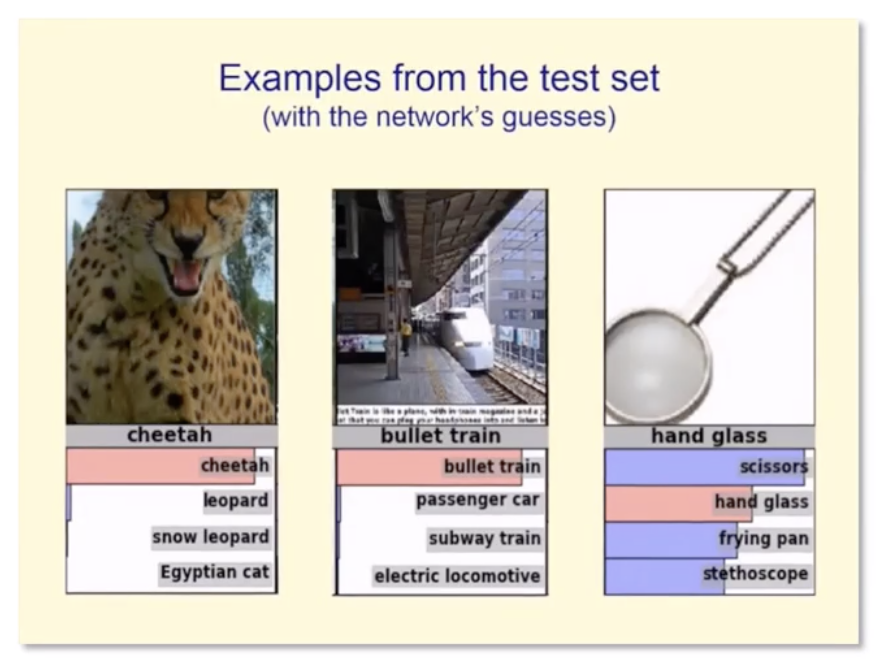

It's an interesting field, now we can train the self drive car, the tool for blind people, recognize people in images. 

And the most important is video surveillance 

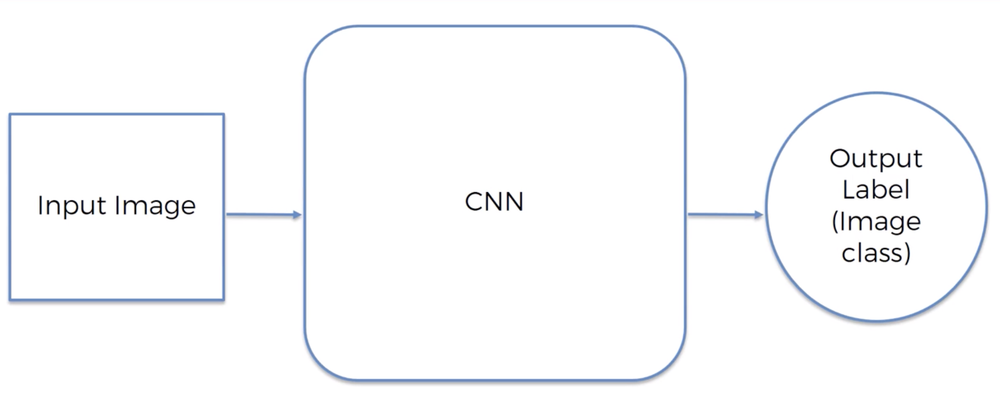

### Emotion Recognition 


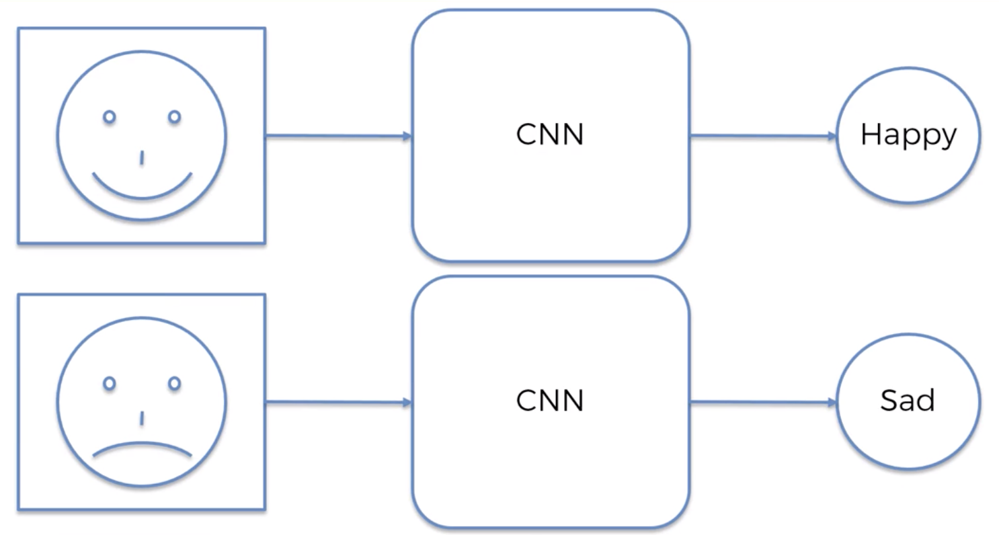

## What is an image? 

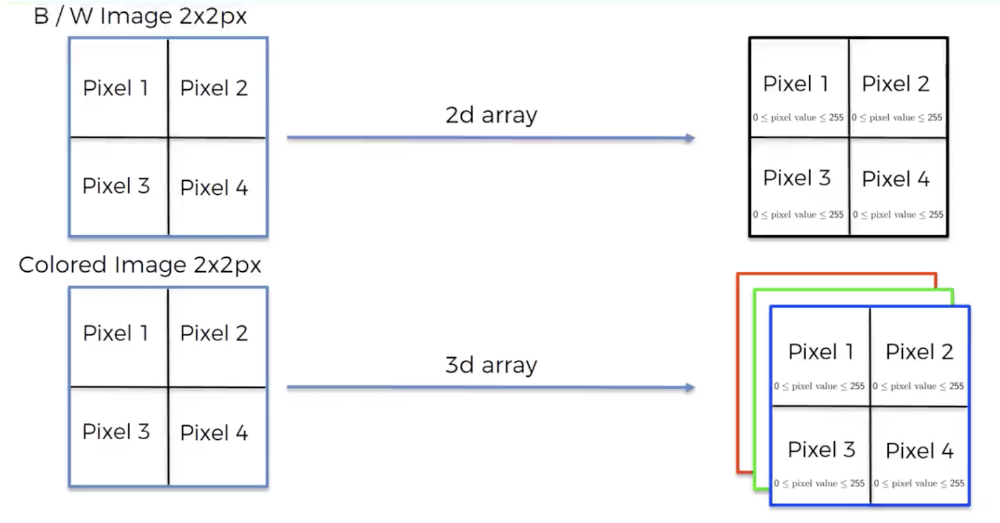


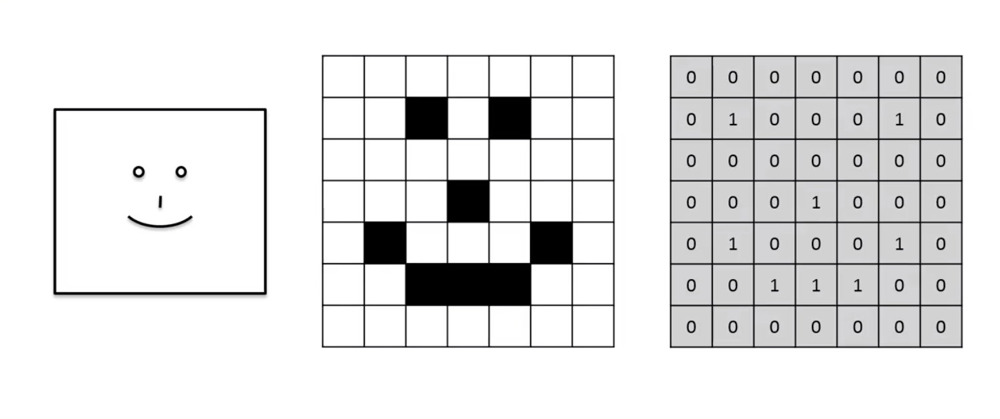

## How to build a CNN ? 

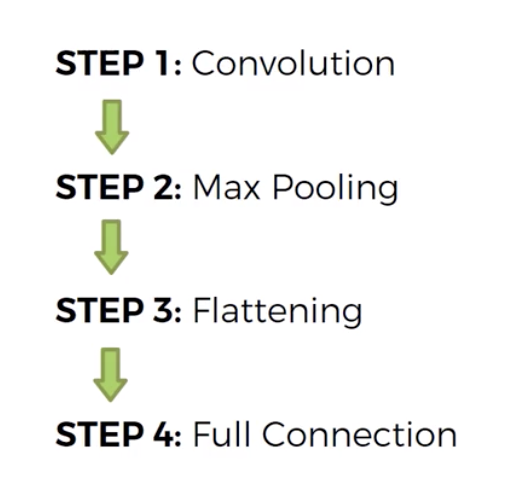

## 1 - The Convolution 

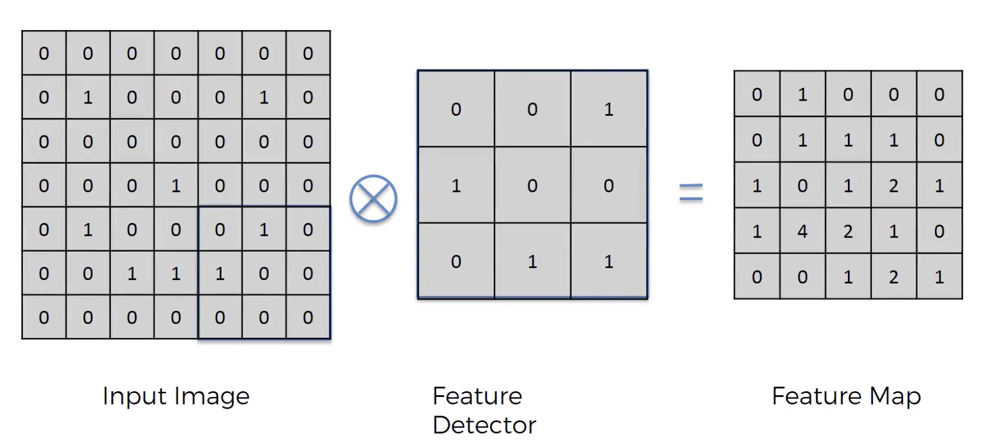

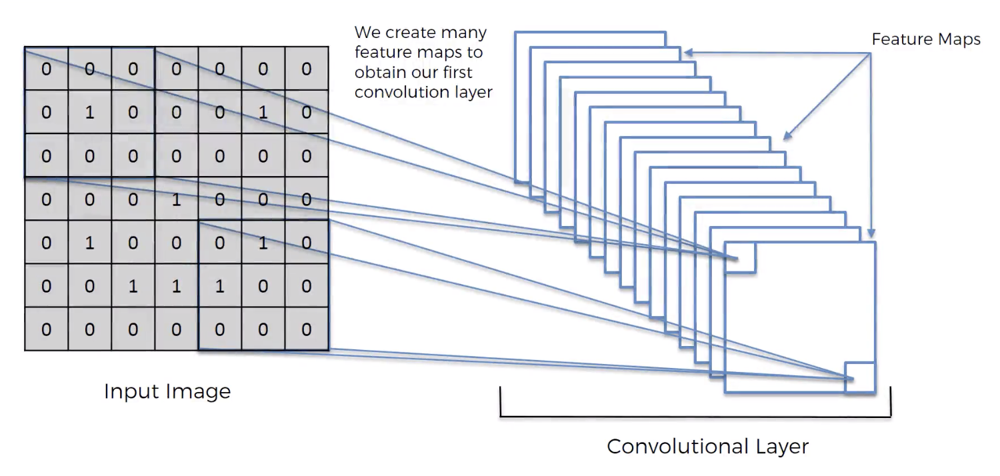


The feature detector can reduce the size of pixels.

We can say that the feature is HOW WE SEE. 

The feature map helps us preserve the important part of the image.

We create multiple feature maps because it is the way we want to preserve all the information. We donì't just use a single feature map, we look for some features and we use a lot of feature because with the training we will use the featutures we need. 



### Some filters 

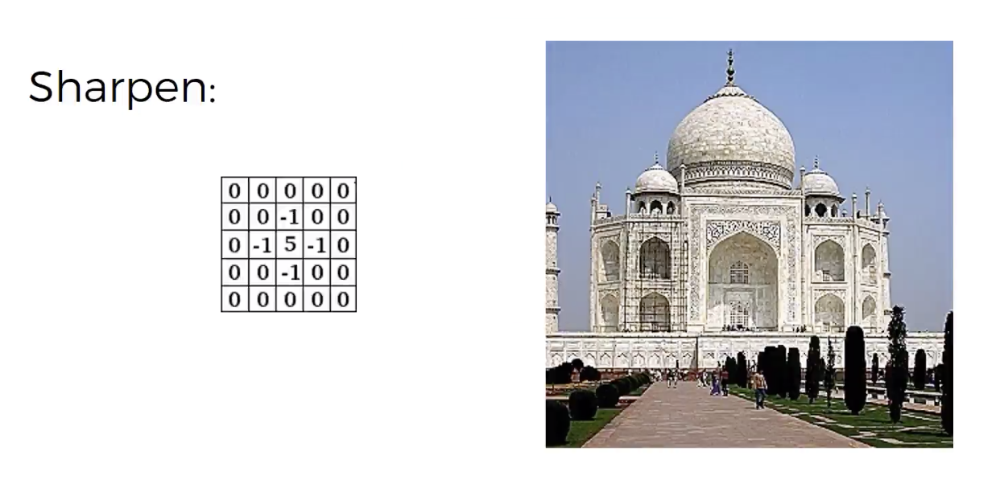

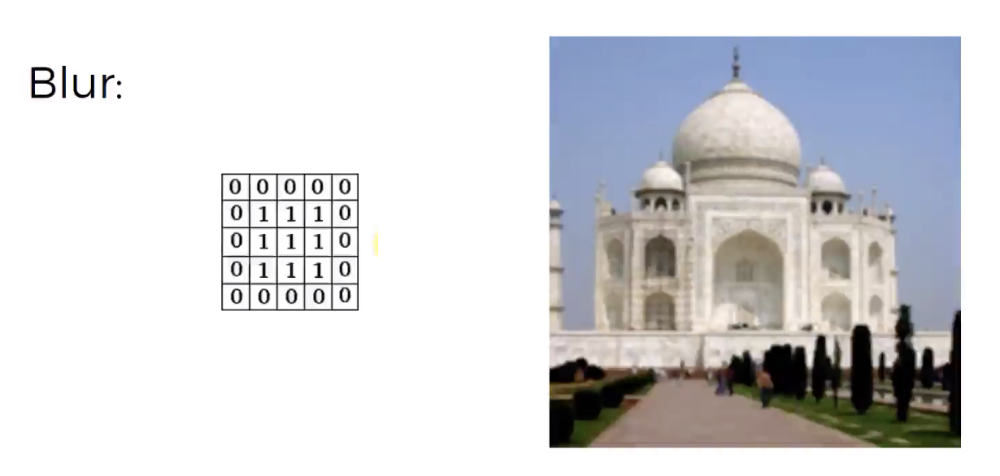


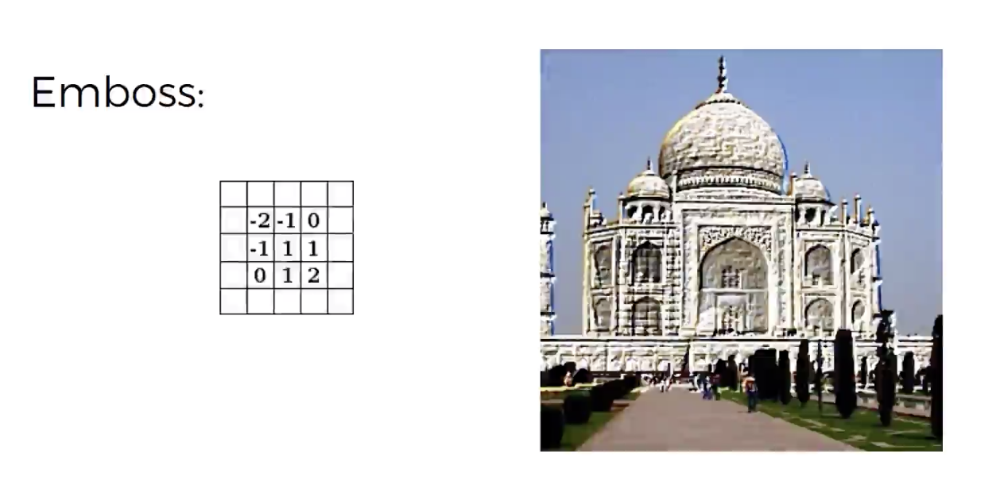

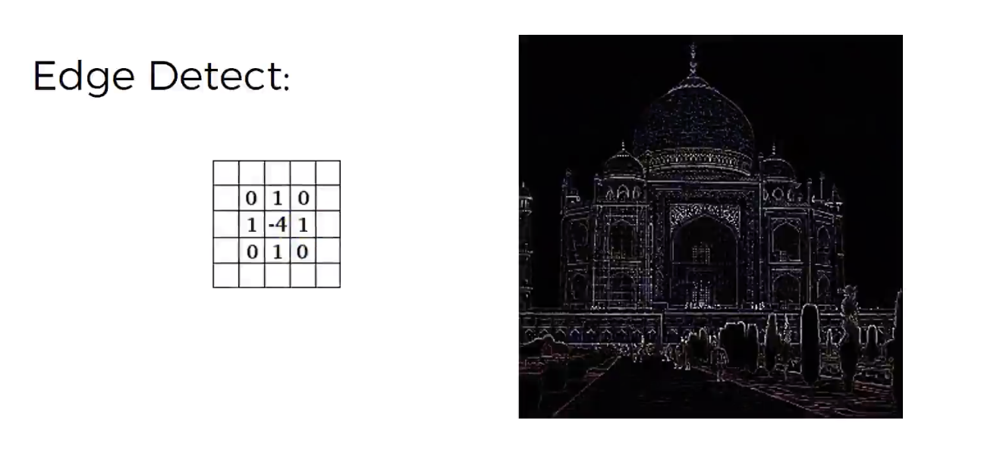

The feature filter enhances some feature of the image.


The way a computer sees an image is different from the way we see an image. 


### Rectifier function 
After the convolutional Layer I apply the rectifier function because I want to encrese the non linearity in our image. 



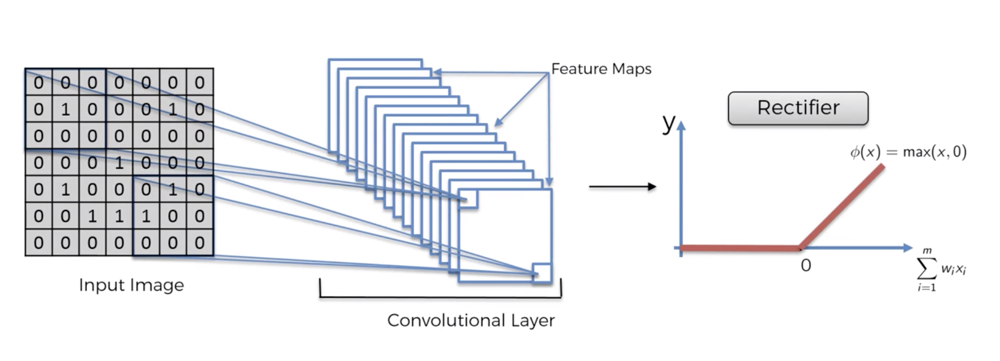



## 2 - MAX POOLING 

In these 3 images we have the same cheeta in 3 different rotation.
We want a neural network able to recognize all these chetas in different rotations. 

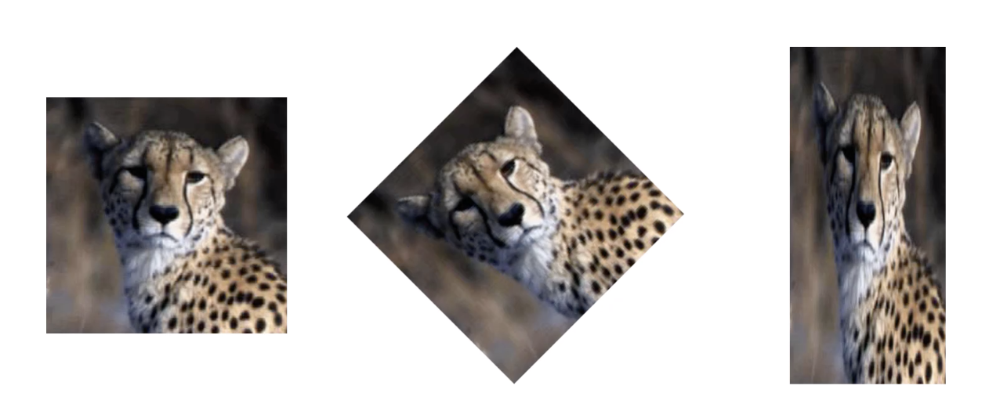
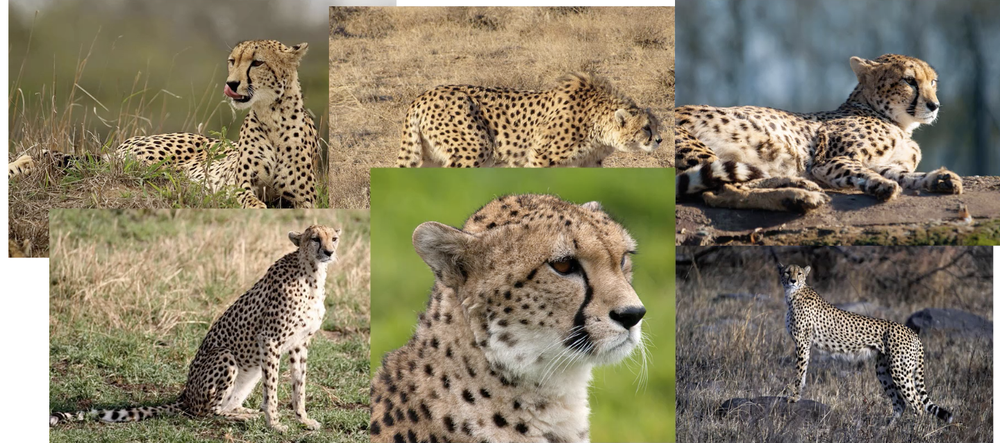

We want to be sure that our CNN has a spatial invariance. 
We want that our model is a little flexible 


With the max pooling we take the maximum value of the image.

Another benefit is that we are reducing the size of the matrix and we are reducing the number of parameters and so we are preventing overfitting.

That is a good thing because in that way.


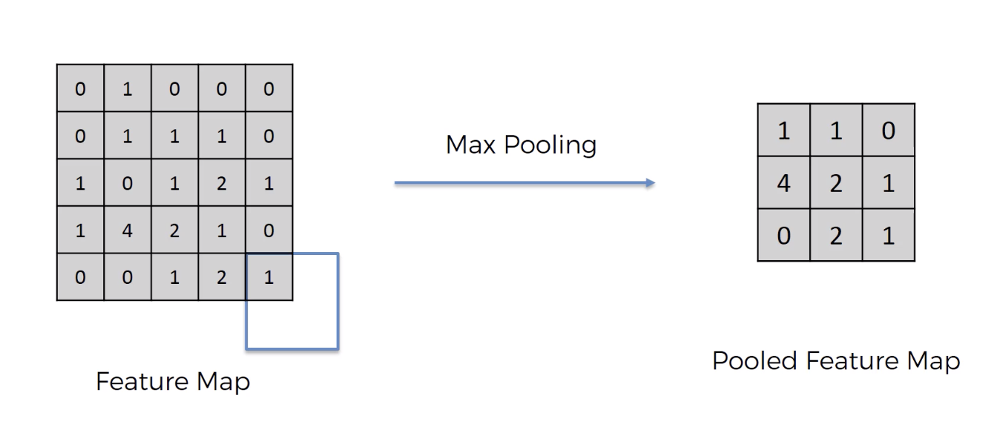


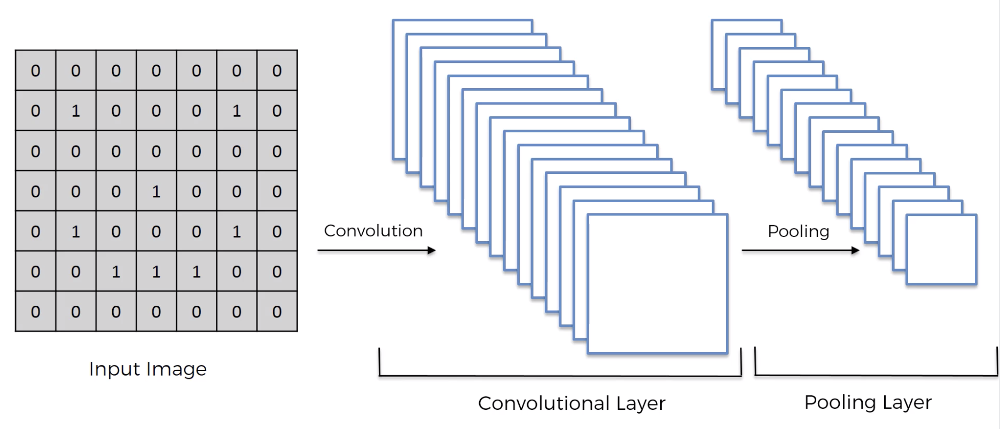

http://scs.ryerson.ca/~aharley/vis/conv/flat.html


## 3 - Flattening 

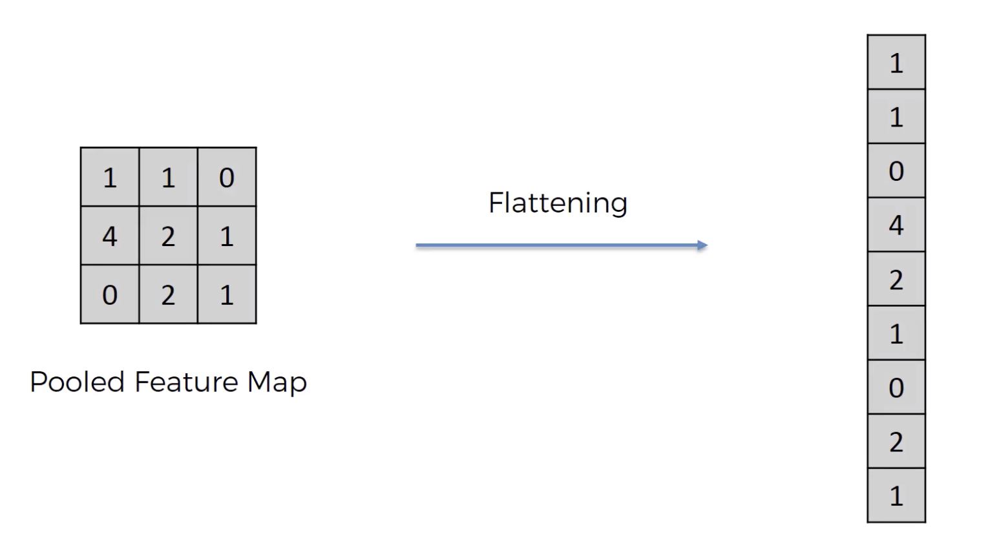



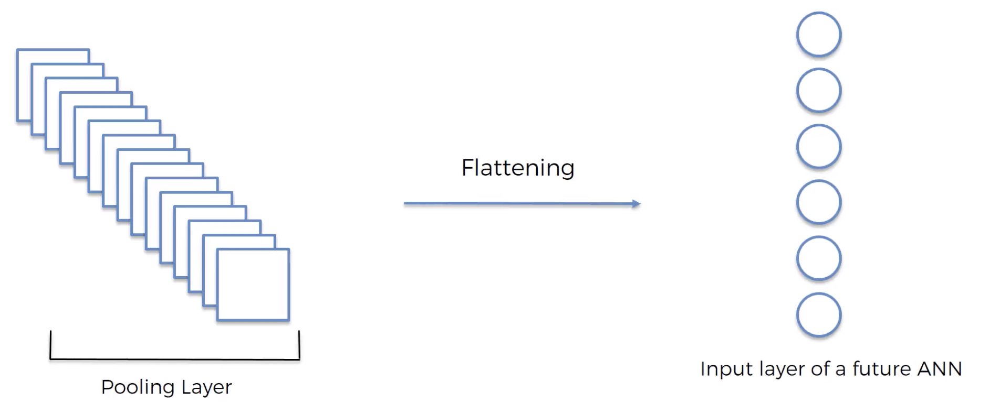

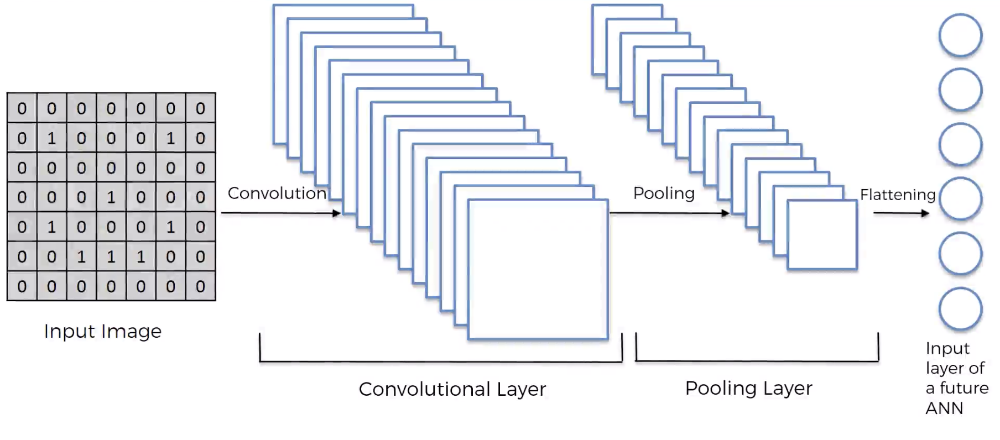


## 4 - Full Connection 

And then ... 

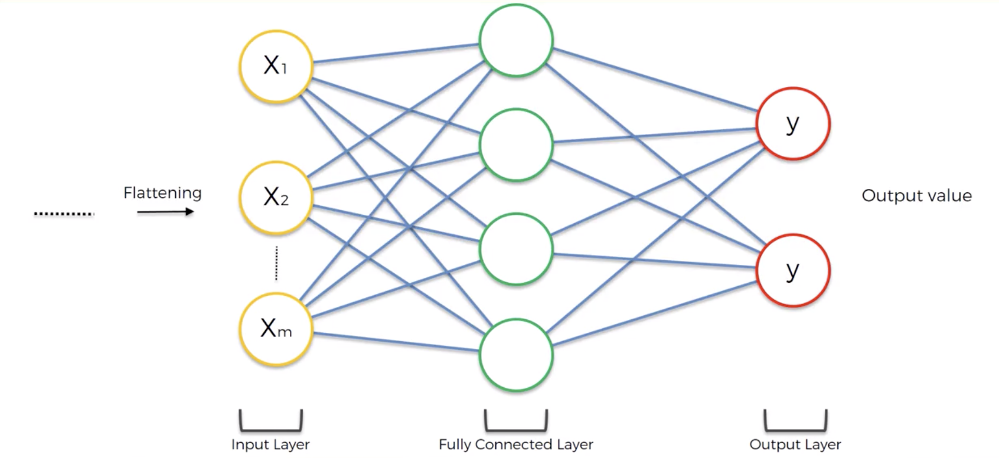

Am artificial neural network with a layre fully connected.

In the input layer we have out flattened features. 


Here we have as many output as many classes. 
So we have also the probability of that class. 

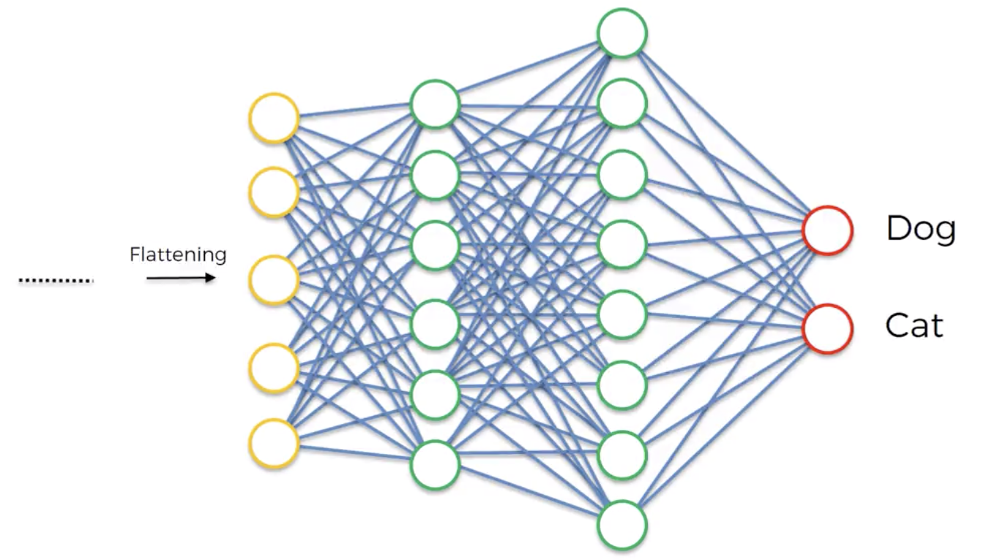


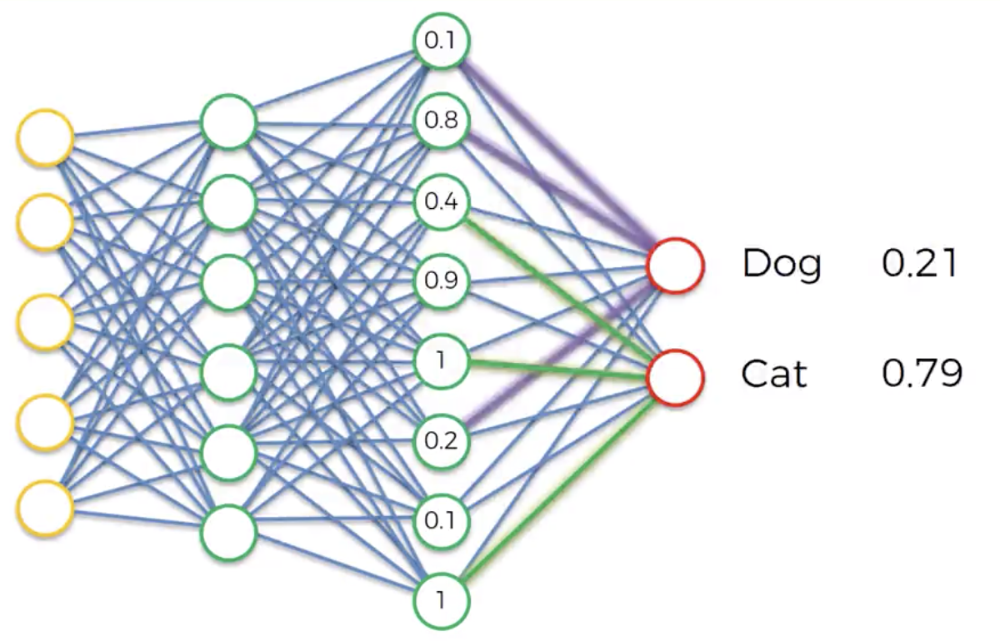

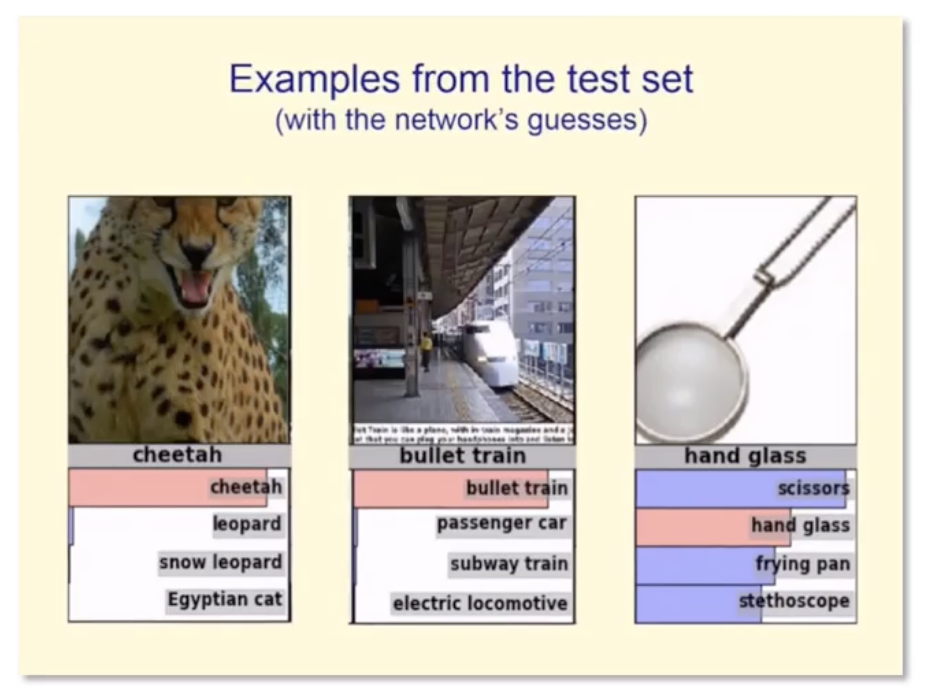


## Summary 

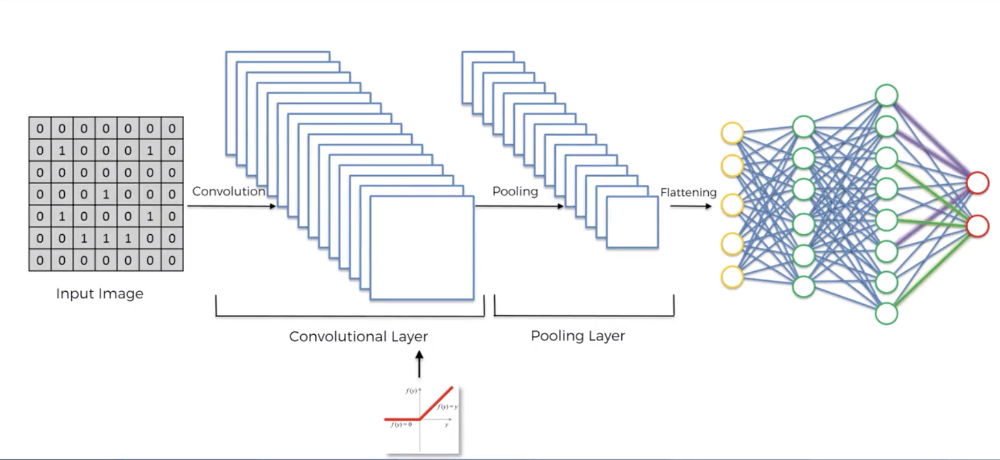


# Softmax & Cross-entropy

...???

# BUILD THE CNN  

We are building a convolutional neural network to predict a CAT or a DOG.

Keras understand the class if you use different folders for each class of image.



In [3]:
# importing the Keras libearies and packages
# each package correspond to each step of the building of CNNfrom keras.models import Sequential

from keras.models import Sequential
from keras.layers import Conv2D
from keras.layers import MaxPooling2D
from keras.layers import Flatten
from keras.layers import Dense

# Initialising the CNN

classifier = Sequential()

Conv2D( 
- nb_filters = number of feature map we want to create 
- nb_rows = the dimension (rows) of the filters
- nb_columns = the dimension (columns) of the filters 
- input_shape = the expected format of the matrix in input 
- activation = 'relu'  the activation function 
)

In [4]:
# Step 1 - Convolution
classifier.add(Conv2D(32, (3, 3), input_shape = (64, 64, 3), activation = 'relu'))

MaxPooling2D(
- pool_size = 2x2 
)

In [5]:
# Step 2 -- Max Pooling 
classifier.add(MaxPooling2D(pool_size= (2,2)))

Flatten(
No input parameter because the network understand what is the input
)

In [6]:
# Step 3 -- Flattening 
classifier.add(Flatten() )

### Now we need to create a classic ANN 

In [7]:
# Step 4 - Full connection
classifier.add(Dense(output_dim = 128, activation='relu'))

# output = 1 - the prediction of only one class
classifier.add(Dense(output_dim = 1, activation='sigmoid')) #output the probability 

/Users/Paola/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(activation="relu", units=128)`
  
/Users/Paola/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(activation="sigmoid", units=1)`
  """


In [8]:
#compiling the CNN

classifier.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


# ImageDataGenerator




## Now we have to fit our CNN to our images 
We need to preprocess images in order to reduce overfitting

https://keras.io/preprocessing/image/

ImageDataGenerator (
- **rescale**: rescaling factor. Defaults to None. If None or 0, no rescaling is applied, otherwise we multiply the data by the value provided (after applying all other transformations).
- **shear_range**: Float. Shear Intensity (Shear angle in counter-clockwise direction in degrees)
- **zoom_range**: Float or [lower, upper]. Range for random zoom. If a float, [lower, upper] = [1-zoom_range, 1+zoom_range].
- **horizontal_flip**: Boolean. Randomly flip inputs horizontally.

)



# Image agumentation 


Image Augmentations techniques are methods of artificially increasing the variations of images in our data-set by using horizontal/vertical flips, rotations, variations in brightness of images, horizontal/vertical shifts etc.

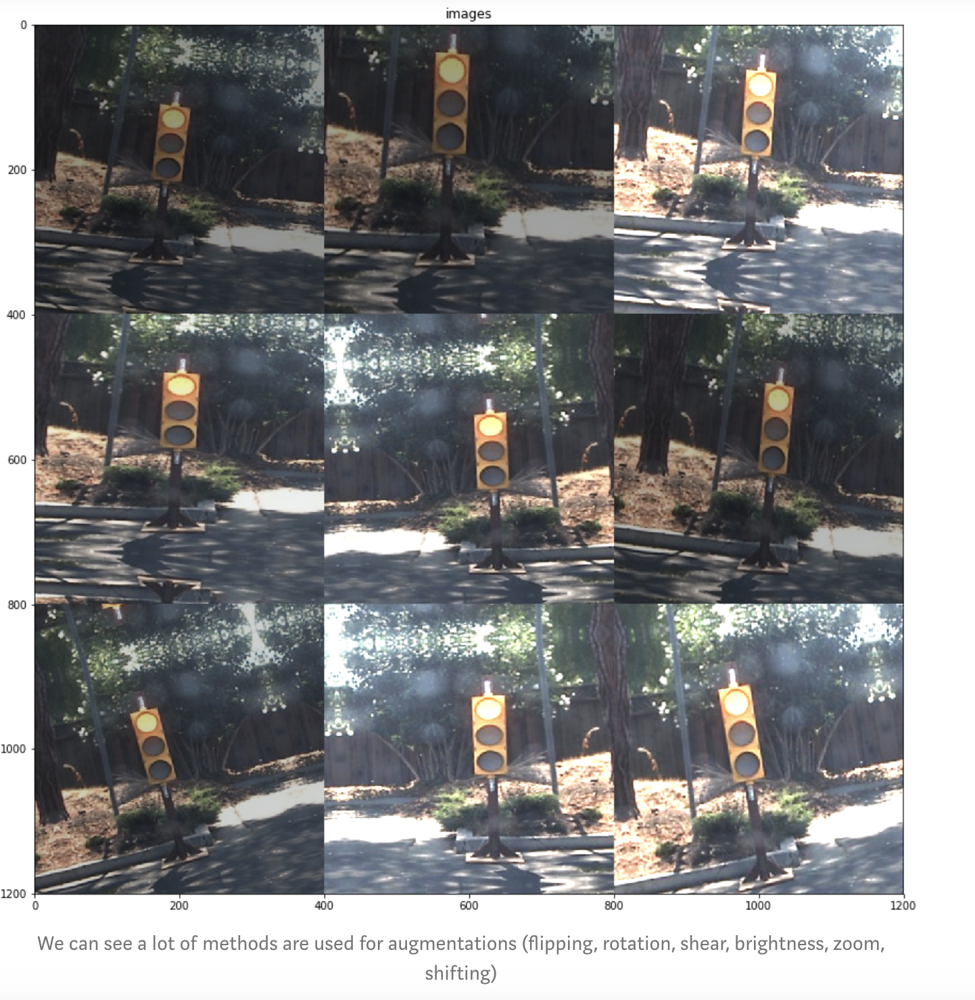



In [9]:
# Part 2 - Fitting the CNN to the images

from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale = 1./255,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True)

test_datagen = ImageDataGenerator(rescale = 1./255)



training_set = train_datagen.flow_from_directory('dataset/training_set',
                                                 target_size = (64, 64),  # the size of the images expected in my cnn model
                                                 batch_size = 32,
                                                 class_mode = 'binary')


test_set = test_datagen.flow_from_directory('dataset/test_set',
                                            target_size = (64, 64),
                                            batch_size = 32,
                                            class_mode = 'binary')

classifier.fit_generator(training_set,
                         steps_per_epoch = 8000,
                         epochs = 25,
                         validation_data = test_set,
                         validation_steps = 2000)

Found 8000 images belonging to 2 classes.
Found 2000 images belonging to 2 classes.


TypeError: fit_generator() got an unexpected keyword argument 'sample_per_epoch'

In [ ]:
# Importing the Keras libraries and packages
from keras.models import Sequential
from keras.layers import Conv2D
from keras.layers import MaxPooling2D
from keras.layers import Flatten
from keras.layers import Dense

# Initialising the CNN
classifier = Sequential()

# Step 1 - Convolution
classifier.add(Conv2D(32, (3, 3), input_shape = (64, 64, 3), activation = 'relu'))

# Step 2 - Pooling
classifier.add(MaxPooling2D(pool_size = (2, 2)))

# Adding a second convolutional layer
classifier.add(Conv2D(32, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))

# Step 3 - Flattening
classifier.add(Flatten())

# Step 4 - Full connection
classifier.add(Dense(units = 128, activation = 'relu'))
classifier.add(Dense(units = 1, activation = 'sigmoid'))

# Compiling the CNN
classifier.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])

# Part 2 - Fitting the CNN to the images

from keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale = 1./255,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True)

test_datagen = ImageDataGenerator(rescale = 1./255)

training_set = train_datagen.flow_from_directory('dataset/training_set',
                                                 target_size = (64, 64),
                                                 batch_size = 32,
                                                 class_mode = 'binary')

test_set = test_datagen.flow_from_directory('dataset/test_set',
                                            target_size = (64, 64),
                                            batch_size = 32,
                                            class_mode = 'binary')

classifier.fit_generator(training_set,
                         steps_per_epoch = 8000,
                         epochs = 25,
                         validation_data = test_set,
                         validation_steps = 2000)

fit_generator(generator, steps_per_epoch=None, epochs=1, verbose=1, callbacks=None, validation_data=None, validation_steps=None, validation_freq=1, class_weight=None, max_queue_size=10, workers=1, use_multiprocessing=False, shuffle=True, initial_epoch=0)

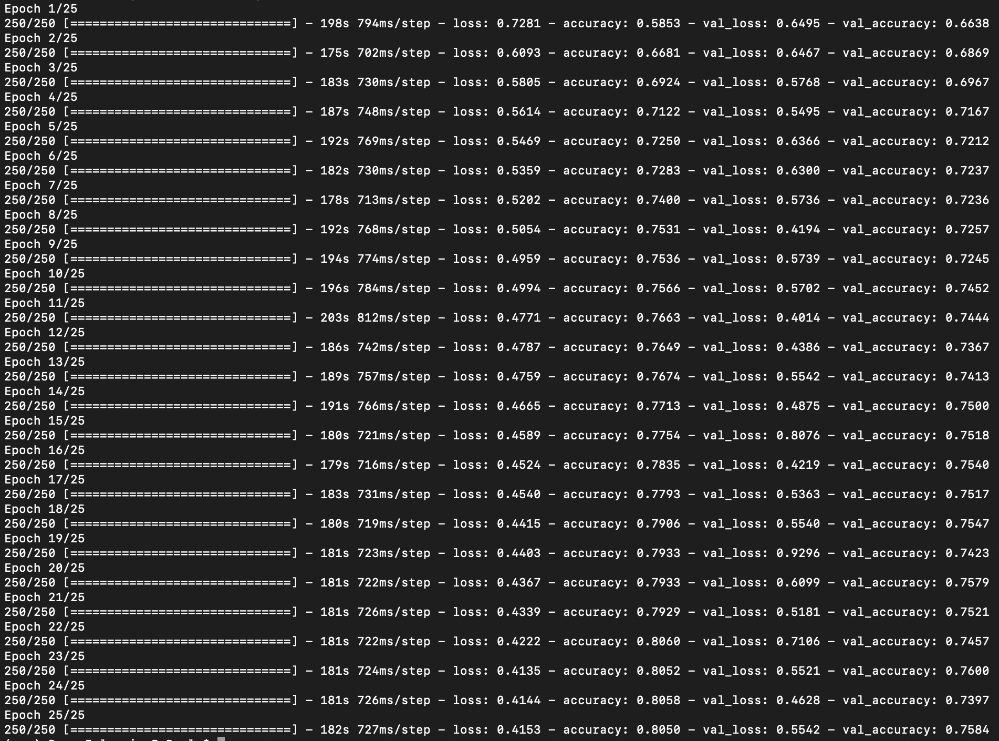


In [ ]:
# improve adding an other convolutional layer

# Adding a second convolutional layer
classifier.add(Conv2D(32, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))


# Homework

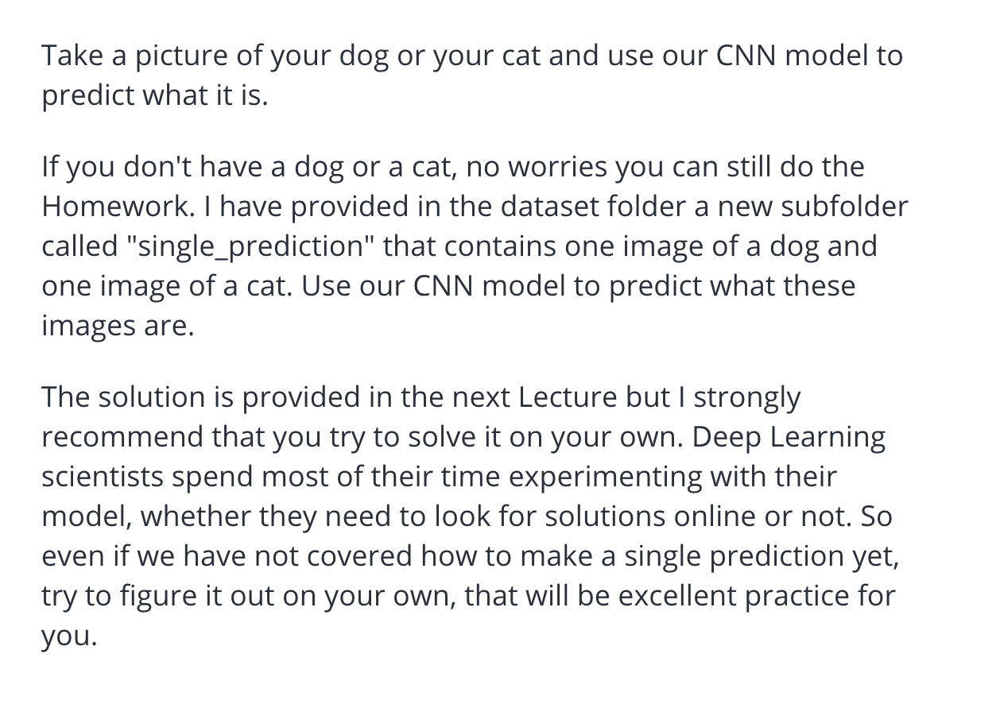